In [1]:
import shap
import os,sys
from transformers import AutoModelForSequenceClassification, AutoTokenizer, BertTokenizerFast
from transformers_interpret import MultiLabelClassificationExplainer # https://github.com/cdpierse/transformers-interpret#visualize-classification-attributions
#import database_preparation.utils_labeled_datasets as dt
from transformers import Trainer, PreTrainedTokenizerFast, BertForSequenceClassification
from transformers import TrainingArguments
import numpy as np
import torch
from torch import nn
from transformers import BertTokenizer, BertModel, TextClassificationPipeline
import pandas as pd
import datasets
import pandas as pd
import numpy as np
import json
import os
import re
import datasets
from transformers import BertModel,BertTokenizer,AdamW, get_linear_schedule_with_warmup
from transformers import AutoModelForSequenceClassification, PreTrainedTokenizerFast

2023-01-22 21:01:13.371367: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-22 21:01:15.439045: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-01-22 21:01:15.439098: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-01-22 21:01:15.673776: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-01-22 21:01:19.607212: W tensorflow/stream_executor/platform/de

#### load_data

In [2]:
data_path_organs = "/home/fb198/BA/DataNephroTexts/classification_data/filtered_organs_balanced.json"
data_organs = datasets.Dataset.from_json(data_path_organs)

data_path_disease = "/home/fb198/BA/DataNephroTexts/classification_data/disease/undersampled_filtered_dataset_disorder.json"
data_disease = datasets.Dataset.from_json(data_path_disease)

int2organ = {
    0: 'colon',
    1: 'prostate',
    2: 'stomach'
}
labels_organs = list(int2organ.values())
organ2int = {
    'colon': 0,
    'prostate': 1,
    'stomach': 2
}

Using custom data configuration default-d3fc66718eb2f124
Reusing dataset json (/home/fb198/.cache/huggingface/datasets/json/default-d3fc66718eb2f124/0.0.0)
Using custom data configuration default-42555671adc4b595
Reusing dataset json (/home/fb198/.cache/huggingface/datasets/json/default-42555671adc4b595/0.0.0)


In [9]:
med_bert_p = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/TextClassification/models_my_tokenizer/organs/balanced_organs/default_balanced_organs/bert-base-german-cased_dataset_organ_ClassificatonModel_4_greatt/trainer/checkpoint-4600"
med_t_p = "smanjil/German-MedBERT"
tokenizer_med = BertTokenizer.from_pretrained(med_t_p)
#model_med = BertForSequenceClassification.from_pretrained(med_bert_p)#.cpu()
#, id2label=int2organ
#pipe = TextClassificationPipeline(model=model_med, tokenizer=tokenizer_med, return_all_scores=True)

In [6]:
model_med.config.problem_type

'single_label_classification'

In [3]:
def get_pipe(model_path, tokenizer_path, fast_tokenizer = True):
    if fast_tokenizer:
        tokenizer = PreTrainedTokenizerFast.from_pretrained(tokenizer_path)
        
    model = BertForSequenceClassification.from_pretrained(model_path)
    pip = TextClassificationPipeline(model = model, tokenizer=tokenizer, return_all_scores=True)
    return pip

In [4]:
def score_and_visualize(pip,text, label_list):
    prediction = pip([text])
    print(prediction[0])
    explainer = shap.Explainer(pip)
    explainer.feature_names = label_list
    print(explainer.feature_names)
    shap_values = explainer([text])

    shap.plots.text(shap_values)


#### paths organs

In [5]:
## path of fine tuned model using sp v1000
sp_balanced_organs_1000_p = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/TextClassification/models_my_tokenizer/organs/balanced_organs/balanced_organs_v1000/sp_balanced_organs_1000/sentencepiece_algo_pre_trained_dataset_organ_ClassificatonModel_4_good/trainer/checkpoint-4600"
sp_tokenizer_v1000 = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/LanguageModelling/most_relevant/sp_v1000_PT"
##         fine tuned model unsing wp v1000
wp_balanced_organs = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/TextClassification/models_my_tokenizer/organs/balanced_organs/balanced_organs_v1000/balanced_organs_wp_1000/1_wp_1_batch_size_8_try_2_dataset_organ_ClassificatonModel_4_fantastic/trainer/checkpoint-4600"
wp_tokenizer_v1000="/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/LanguageModelling/most_relevant/wp_v1000_PT"

## MedBert
MedBert_finetuned = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/TextClassification/models_my_tokenizer/organs/balanced_organs/medBert_dafult/German-MedBERT_dataset_organs_balanced_ClassificatonModel_4/trainer/checkpoint-4600"
MedBert_tokenizer = "bert-base-german-cased"

##Bert pre trained
ptho_bert_fintuned = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/TextClassification/models_my_tokenizer/organs/balanced_organs/default_balanced_organs/bert-base-german-cased_dataset_organ_ClassificatonModel_4_greatt/trainer/checkpoint-4600"
patho_tokenizer_paht = "/home/fb198/BA/nlp-in-diagnostic-texts-from-nephropathology-master/LanguageModelling/most_relevant/default_PT"

In [11]:
organs_sp = get_pipe(sp_balanced_organs_1000_p, sp_tokenizer_v1000)
organs_wp = get_pipe(wp_balanced_organs, wp_tokenizer_v1000)
default_bert = get_pipe(MedBert_tokenizer, MedBert_tokenizer)
#MedBert_pipe = get_pipe(MedBert_finetuned, default_bert_tk_path)
patho_pipe = get_pipe(ptho_bert_fintuned, patho_tokenizer_paht)

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'PreTrainedTokenizerFast'.
Some weights of the model checkpoint at bert-base-german-cased were not used when initializing BertForSequenceClassification: ['cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are init

In [12]:
prediction_exp = organs_sp([data_organs['text'][3650]])
print(prediction_exp[0])
explainer_exp = shap.Explainer(organs_sp)
explainer_exp.feature_names = labels_organs
print(explainer_exp.feature_names)
shap_values_exp = explainer_exp([data_organs['text'][3650]])
#shap.summary_plot(shap_values_exp, )
#shap.plots.text(shap_values)


[{'label': 'LABEL_0', 'score': 0.00027520881849341094}, {'label': 'LABEL_1', 'score': 8.097276440821588e-05}, {'label': 'LABEL_2', 'score': 0.9996438026428223}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:49, 109.26s/it]                                    


In [ ]:
score_and_visualize()

In [19]:
shap.plots(shap_values_exp.values)

TypeError: 'module' object is not callable

In [15]:
#explainer_exp.summary_plot(shap_values_exp )
shap.plots.text(shap_values)

NameError: name 'shap_values' is not defined

In [199]:
def get_n_shap_values(pip, text, label_list,n=5):
    prediction = pip([text])
    print(prediction[0])
    explainer = shap.Explainer(pip)
    explainer.feature_names = label_list
    print(explainer.feature_names)
    shap_values = explainer([text])
    
    ##
    values = shap_values.values[0]
    labels_val = shap_values_exp.base_values[0]
    data = shap_values.data[0]
    
    
    mean_vales = np.abs(values).mean(0)    
    label_idx = np.where(labels_val == max(labels_val))
    
    shap_values_for_label = values[:,label_idx[0][0]]
    
    top_positive_values_idx = np.argpartition(shap_values_for_label, -n)[-n:]
    top_positive_word = data[top_positive_values_idx]
    top_positive_values = shap_values_for_label[top_positive_values_idx]

    top_negative_values_idx = np.argpartition(shap_values_for_label, -n)[:n]
    top_negative_word = data[top_negative_values_idx]
    top_negative_values = shap_values_for_label[top_negative_values_idx]
    
    return {
        "top_p_words" : top_positive_word,
        "top_p_val" :top_positive_values,
        "top_n_words" : top_negative_word,
        "top_n_val" : top_negative_values
    }


In [200]:
dict_ = get_n_shap_values(organs_wp, data_organs['text'][3650], labels_organs, 10)
dict_

[{'label': 'LABEL_0', 'score': 0.00011081855336669832}, {'label': 'LABEL_1', 'score': 0.00046500167809426785}, {'label': 'LABEL_2', 'score': 0.9994242191314697}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:13, 73.15s/it]                                     


{'top_p_words': array(['emisch ', 'ma', 'ak', 'Korpus', 'lymph', 'F', 'Korpus', 'in', ')',
        'pylori'], dtype=object),
 'top_p_val': array([0.02772483, 0.03669938, 0.03489133, 0.03428109, 0.08859956,
        0.03256129, 0.07645605, 0.03090788, 0.02793165, 0.07900501]),
 'top_n_words': array(['und ', '1 ', 'PE ', '1 ', 'Antrum', ')', ': ', 'maximal', 'er ',
        'Durchmesser '], dtype=object),
 'top_n_val': array([ 0.00014906, -0.00015281, -0.00015281, -0.00015281, -0.00015281,
        -0.00015281, -0.00015281, -0.00015281, -0.00015281, -0.00015281])}

In [263]:
temp_dict

{'top_p_words': array(['und ', 'änderungen ', 'von ', 'von ', 'Dr', 'Magen', 'Im ',
        'Kein ', 'schlei', 'Nachweis '], dtype=object),
 'top_p_val': array([0.02413123, 0.02413123, 0.02421754, 0.04354062, 0.04595452,
        0.20357614, 0.04625338, 0.05940307, 0.14132153, 0.04690798]),
 'top_n_words': array(['maximale ', 'und ', '(', 'P', 'E ', '1 ', 'Ant', 'rum', ')', ': '],
       dtype=object),
 'top_n_val': array([-0.01180342, -0.00193449, -0.00083462, -0.00083462, -0.00083462,
        -0.00083462, -0.00122619, -0.00122619, -0.00122619, -0.01645205])}

In [255]:
bag_of_pipes = [organs_sp, organs_wp, MedBert_pipe]
models_name = ["sp", "wp", "default"]
#total_dict = dict()
for text_num in [3200,2900,1500,2100, 200, 3650]: #3650, 3200,2900,1500,2100, 200, 0
    for idx_, i in enumerate(bag_of_pipes):
        temp_dict = get_n_shap_values(i, data_organs['text'][text_num], labels_organs, 10)
        title_ = str(text_num) + "_" + models_name[idx_]
        total_dict[title_] = temp_dict
    

[{'label': 'LABEL_0', 'score': 8.004833944141865e-05}, {'label': 'LABEL_1', 'score': 0.0019219371024519205}, {'label': 'LABEL_2', 'score': 0.9979979395866394}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:15, 75.96s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00011001031816704199}, {'label': 'LABEL_1', 'score': 0.00047304219333454967}, {'label': 'LABEL_2', 'score': 0.9994169473648071}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:48, 48.35s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00010839616879820824}, {'label': 'LABEL_1', 'score': 0.00019383877224754542}, {'label': 'LABEL_2', 'score': 0.9996978044509888}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:30, 30.02s/it]                                     


[{'label': 'LABEL_0', 'score': 0.0007288047345355153}, {'label': 'LABEL_1', 'score': 0.998525083065033}, {'label': 'LABEL_2', 'score': 0.0007461255881935358}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:37, 97.67s/it]                                     


[{'label': 'LABEL_0', 'score': 0.000132386339828372}, {'label': 'LABEL_1', 'score': 0.9984130859375}, {'label': 'LABEL_2', 'score': 0.0014546015299856663}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:57, 57.89s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00016439474711660296}, {'label': 'LABEL_1', 'score': 0.9992198944091797}, {'label': 'LABEL_2', 'score': 0.0006157197640277445}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:25, 25.73s/it]                                     


[{'label': 'LABEL_0', 'score': 7.795923011144623e-05}, {'label': 'LABEL_1', 'score': 0.002410600194707513}, {'label': 'LABEL_2', 'score': 0.9975113868713379}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:57, 57.50s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00010739322897279635}, {'label': 'LABEL_1', 'score': 0.00048562834854237735}, {'label': 'LABEL_2', 'score': 0.9994069337844849}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:40, 40.44s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00010947918781312183}, {'label': 'LABEL_1', 'score': 0.0004620644322130829}, {'label': 'LABEL_2', 'score': 0.9994284510612488}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:26, 26.64s/it]                                     


[{'label': 'LABEL_0', 'score': 0.005673425737768412}, {'label': 'LABEL_1', 'score': 0.9933717250823975}, {'label': 'LABEL_2', 'score': 0.0009548585512675345}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:27, 87.93s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00014919058594387025}, {'label': 'LABEL_1', 'score': 0.9983653426170349}, {'label': 'LABEL_2', 'score': 0.0014854721957817674}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:51, 51.92s/it]                                     


[{'label': 'LABEL_0', 'score': 0.009824183769524097}, {'label': 'LABEL_1', 'score': 0.989303469657898}, {'label': 'LABEL_2', 'score': 0.0008723343489691615}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:32, 32.02s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00010061413195217028}, {'label': 'LABEL_1', 'score': 0.0001967057032743469}, {'label': 'LABEL_2', 'score': 0.9997026324272156}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:55, 55.79s/it]                                     


[{'label': 'LABEL_0', 'score': 0.0001475949102314189}, {'label': 'LABEL_1', 'score': 0.0003309674502816051}, {'label': 'LABEL_2', 'score': 0.9995214939117432}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:39, 39.91s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00010947165719699115}, {'label': 'LABEL_1', 'score': 0.00022850323875900358}, {'label': 'LABEL_2', 'score': 0.9996620416641235}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:19, 19.49s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00027520881849341094}, {'label': 'LABEL_1', 'score': 8.097276440821588e-05}, {'label': 'LABEL_2', 'score': 0.9996438026428223}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:39, 99.07s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00011081855336669832}, {'label': 'LABEL_1', 'score': 0.00046500167809426785}, {'label': 'LABEL_2', 'score': 0.9994242191314697}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:58, 58.70s/it]                                     


[{'label': 'LABEL_0', 'score': 0.00012933151447214186}, {'label': 'LABEL_1', 'score': 0.00013096601469442248}, {'label': 'LABEL_2', 'score': 0.9997397065162659}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:23, 23.19s/it]                                     


In [260]:
total_dict.keys()

dict_keys(['sp', 'wp', 'default', '3200_sp', '3200_wp', '3200_default', '2900_sp', '2900_wp', '2900_default', '1500_sp', '1500_wp', '1500_default', '2100_sp', '2100_wp', '2100_default', '200_sp', '200_wp', '200_default', '3650_sp', '3650_wp', '3650_default'])

In [262]:
pd.DataFrame(total_dict['3200_default'])

,top_p_words,top_p_val,top_n_words,top_n_val
0,yp,0.020065,),-0.001800
1,haut,0.023368,,-0.004709
2,lei,0.023377,.,-0.021309
3,m,0.023377,vorliegenden,-0.024901
4,den,0.058025,Im,-0.000012
5,ch,0.046561,.,-0.000724
6,schlei,0.055234,2,-0.017053
7,Magen,0.140878,-,-0.001400
8,Duo,0.058025,1,-0.069008
9,als,0.046561,,0.000007


In [254]:
pd.DataFrame(total_dict['default']).to_csv("organs_idx_0_default.csv")

In [194]:
prediction = organs_sp([data_organs['text'][3650]])
print(prediction[0])
explainer = shap.Explainer(organs_sp)
explainer.feature_names = labels_organs
print(explainer.feature_names)
shap_values = explainer([data_organs['text'][3650]])

##


[{'label': 'LABEL_0', 'score': 0.00027520881849341094}, {'label': 'LABEL_1', 'score': 8.097276440821588e-05}, {'label': 'LABEL_2', 'score': 0.9996438026428223}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:52, 112.78s/it]                                    


In [16]:
shap_values

NameError: name 'shap_values' is not defined

In [198]:
values = shap_values.values[0]
labels_val = shap_values_exp.base_values[0]
data = shap_values.data[0]


mean_vales = np.abs(values).mean(0)    
label_idx = np.where(labels_val == max(labels_val))

shap_values_for_label = values[:,label_idx[0][0]]

top_positive_values_idx = np.argpartition(shap_values_for_label, -10)[-10:]
top_positive_word = data[top_positive_values_idx]
top_positive_values = shap_values_for_label[top_positive_values_idx]

top_negative_values_idx = np.argpartition(shap_values_for_label, -10)[:10]
top_negative_word = data[top_negative_values_idx]
top_negative_values = shap_values_for_label[top_negative_values_idx]



In [197]:
shap_values_for_label

array([[-8.89511922e-06],
       [-1.38590685e-05],
       [ 7.38300240e-06],
       [ 2.02957899e-05],
       [ 4.50381866e-06],
       [-2.32873628e-06],
       [-2.32873628e-06],
       [-1.09007725e-06],
       [-1.09007725e-06],
       [ 2.27106592e-06],
       [ 2.27106592e-06],
       [ 2.27106592e-06],
       [ 2.27106592e-06],
       [ 6.06092792e-07],
       [ 6.06092792e-07],
       [ 6.06092792e-07],
       [-6.09593609e-07],
       [-6.09593609e-07],
       [ 1.31610208e-06],
       [ 4.39154414e-08],
       [-3.35867158e-06],
       [ 8.55983593e-06],
       [ 1.25347207e-05],
       [-3.30103705e-07],
       [-7.51712001e-06],
       [-8.96439529e-06],
       [-2.30363244e-07],
       [-2.30363244e-07],
       [ 1.17366662e-05],
       [ 5.45023880e-06],
       [ 6.11407223e-08],
       [ 6.11407223e-08],
       [ 6.11407223e-08],
       [ 6.11407223e-08],
       [ 6.11407223e-08],
       [ 6.11407223e-08],
       [ 6.11407223e-08],
       [ 9.01232421e-07],
       [ 9.0

In [183]:
data[top_positive_values_idx]

array([' Corpus', 'gebet', 'gen', '2:', ' Antrum', ' Im', 'freie',
       ' Antrum', ' Magenschleimhaut', ' mit'], dtype=object)

In [128]:
shap_values_exp.data[0][[3,10,7]]

array([' Antrum', '0', ' Durchmesser'], dtype=object)

In [134]:
max_ = np.abs(shap_values_exp.values[0]).mean(0)
b= np.abs(shap_values_exp.values[0])

In [144]:
b[:,2][[10,3,7]]

array([2.27106592e-06, 2.02957899e-05, 1.09007725e-06])

In [123]:
label_index = np.where(shap_values_exp.base_values[0] == (max(shap_values_exp.base_values[0])))[0]
label_index

array([2])

In [103]:
a = shap_values_exp.values[0][:,2]
ind = np.argpartition(a, -4)[-4:]
ind

array([ 3, 59, 60, 61])

In [114]:
#pd.DataFrame
([shap_values_exp.data[0][ind], np.abs(shap_values_exp.values[0][ind]).mean(0)])

[array([' Antrum', 'freie', ' Magenschleimhaut', ' mit'], dtype=object),
 array([2.46232171e-05, 3.18172811e-06, 2.41605482e-05])]

In [49]:
df_shap_values = pd.DataFrame(explainer_exp.values)
vals = np.abs(df_shap_values)

In [112]:
shap.plots.text(shap_values_exp)


In [47]:
shap_importance = pd.DataFrame(list(zip(labels_organs, vals)),
                                  columns=['col_name','feature_importance_vals'])
shap_importance.sort_values(by=['feature_importance_vals'],
                               ascending=False, inplace=True)
shap_importance.head()

,col_name,feature_importance_vals
2,stomach,0.000004
0,colon,0.000004
1,prostate,0.000002


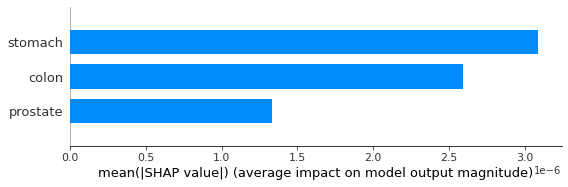

In [120]:
shap.summary_plot(shap_values_exp[0], [data_organs['text'][3650]], max_display=20, plot_type='bar',feature_names=labels_organs,show=True)

In [ ]:
shap.initjs()

shap.force_plot(explainer_exp.expected_value[1],shap_values[1],patient,matplotlib=True,show=False)

In [97]:
score_and_visualize(organs_sp, data_organs['text'][3200],labels_organs)


[{'label': 'LABEL_0', 'score': 8.004833944141865e-05}, {'label': 'LABEL_1', 'score': 0.0019219371024519205}, {'label': 'LABEL_2', 'score': 0.9979979395866394}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [01:27, 87.94s/it]                                     


In [21]:
score_and_visualize(organs_sp, data_organs['text'][3650],labels_organs)


[{'label': 'LABEL_0', 'score': 0.00027520881849341094}, {'label': 'LABEL_1', 'score': 8.097276440821588e-05}, {'label': 'LABEL_2', 'score': 0.9996438026428223}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:49, 109.11s/it]                                    


## Bert WP

In [80]:
print(score_and_visualize(organs_wp, data_organs['text'][3000], labels_organs))

[{'label': 'LABEL_0', 'score': 0.99357670545578}, {'label': 'LABEL_1', 'score': 0.006197645328938961}, {'label': 'LABEL_2', 'score': 0.00022564786195289344}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [02:35, 155.17s/it]                                    


None


In [96]:
print(score_and_visualize(organs_wp, data_organs['text'][3200], labels_organs))

[{'label': 'LABEL_0', 'score': 0.00011001031816704199}, {'label': 'LABEL_1', 'score': 0.00047304219333454967}, {'label': 'LABEL_2', 'score': 0.9994169473648071}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:53, 53.85s/it]                                     


None


In [22]:
print(score_and_visualize(organs_wp, data_organs['text'][3650], labels_organs))

[{'label': 'LABEL_0', 'score': 0.00011081855336669832}, {'label': 'LABEL_1', 'score': 0.00046500167809426785}, {'label': 'LABEL_2', 'score': 0.9994242191314697}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:13, 73.38s/it]                                     


None


# Medbert

In [79]:
print(score_and_visualize(MedBert_pipe, data_organs['text'][3000], labels_organs))

[{'label': 'LABEL_0', 'score': 0.9994468092918396}, {'label': 'LABEL_1', 'score': 0.00011181003355886787}, {'label': 'LABEL_2', 'score': 0.0004413947754073888}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:40, 40.29s/it]                                     


None


In [95]:
print(score_and_visualize(MedBert_pipe, data_organs['text'][3200], labels_organs))

[{'label': 'LABEL_0', 'score': 0.00010839616879820824}, {'label': 'LABEL_1', 'score': 0.00019383877224754542}, {'label': 'LABEL_2', 'score': 0.9996978044509888}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:33, 33.34s/it]                                     


None


In [23]:
print(score_and_visualize(patho_pipe, data_organs['text'][3650], labels_organs))

[{'label': 'LABEL_0', 'score': 0.00016692787175998092}, {'label': 'LABEL_1', 'score': 0.000270013784756884}, {'label': 'LABEL_2', 'score': 0.9995630383491516}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:05, 65.40s/it]                                     


None


In [100]:
data_organs[3650]#['text']

{'index': 2400,
 'text': '1 (PE 1 Antrum): maximaler Durchmesser von 05 cm Schleimhautprobe die in Toto eingebettet ist. 2 (PE Corpus): Fragmentierte maximale Messung von 06 cm Schleimhaut einbetten in toto. 1-2: Antrum- und Korpustyp Dysplasie-freie Magenschleimhaut mit antral gestresster Netzstromafibrose und teilweise regeneratorischen Foveolarveränderungen und leicht erhöhter lymphozellulärer Okkultation. Im Korpusbereich mit Nachweis von Drüsenzysten. Kein Nachweis von Helicobacter pylori. Der Befund nach einer leichten bis mittelschweren chronischen inaktiven chemisch reaktiven Gastritis (Typ C). Kein Anhalt für Bösartigkeit',
 'label': 2,
 'organs': 'stomach'}

In [ ]:
## 2500 3000

# compare wp 1000 with patho

In [ ]:
patho_pipe, organs_wp

In [151]:
print(score_and_visualize(patho_pipe, data_organs['text'][2500], labels_organs))

[{'label': 'LABEL_0', 'score': 0.00015837796672713012}, {'label': 'LABEL_1', 'score': 0.9987002611160278}, {'label': 'LABEL_2', 'score': 0.0011413436150178313}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [01:40, 100.70s/it]                                    


None


In [152]:
print(score_and_visualize(organs_wp, data_organs['text'][2500], labels_organs))

[{'label': 'LABEL_0', 'score': 0.00010950380965368822}, {'label': 'LABEL_1', 'score': 0.9984138011932373}, {'label': 'LABEL_2', 'score': 0.0014766437234357}]
['colon', 'prostate', 'stomach']


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [02:25, 145.99s/it]                                    


None
